<a href="https://colab.research.google.com/github/t0nyj/AbnormalDistribution/blob/master/10514273_Tejaswini_Kale.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#Installing all reqired packages 
!pip install geopandas


In [0]:
pip install plotly_express==0.4.0

In [0]:
pip install plotly

In [0]:
!pip install -U -q ipywidgets
!jupyter nbextension enable --py widgetsnbextension

In [0]:
#Importing labraries required for prforming operations on data to get visuaalization
import altair as alt
from vega_datasets import data
import matplotlib.pyplot as plt
import numpy as np
import requests
import pandas as pd
import geopandas as gpd
import json
from mpl_toolkits.axes_grid1 import make_axes_locatable
import plotly as py
from matplotlib import pyplot as plt
import seaborn as sns
import chart_studio.plotly as py
import warnings
import pycountry
warnings.filterwarnings('ignore')
import plotly.graph_objs as go
import ipywidgets as widgets
from ipywidgets import interact, interact_manual
from  plotly.offline import plot

#py.tools.set_credentials_file(username='tejukale165dbs', api_key='wPmQdROeSaUBGWtRQiiu')



In [0]:
#Disabling maximun number count in altair as we are using large dataset
alt.data_transformers.disable_max_rows()
#Read file athlete for githu repository
ae=pd.read_csv('/content/drive/My Drive/athlete_events.csv')
athlete_events=pd.DataFrame(ae)
#Performing cleaning to remove all null values
athlete_events=athlete_events.dropna()


In [0]:
df=athlete_events.groupby('NOC',as_index=False)['Medal'].count()

In [0]:
athlete_events=athlete_events.merge(df, on='NOC', how='inner')


In [0]:
athlete_events['Metal_num']=athlete_events.Medal_x.astype("category").cat.codes+1


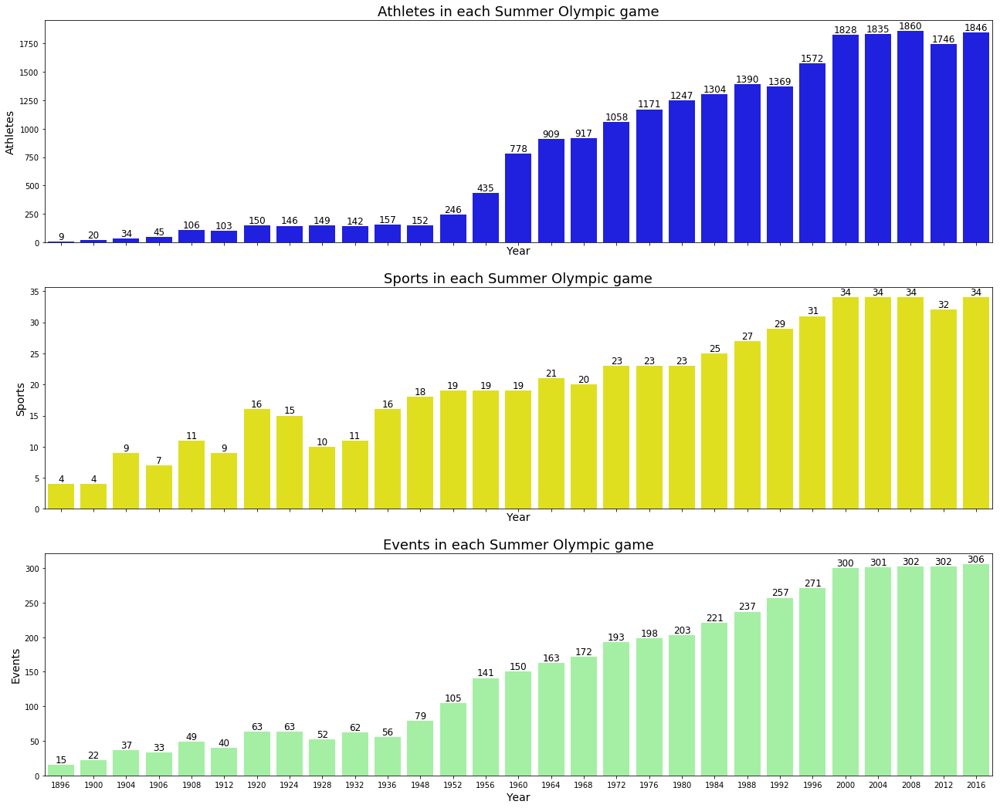

In [305]:
summer = athlete_events[athlete_events['Season']=='Summer']

summer_athletes = summer.pivot_table(summer, index=['Year'], aggfunc=lambda x: len(x.unique())).reset_index()[['Year','ID']]
summer_sports = summer.groupby('Year')['Sport'].nunique().reset_index()
summer_events = summer.groupby('Year')['Event'].nunique().reset_index()

fig, ax = plt.subplots(3, 1, sharex=True, figsize=(22,18))

sns.barplot(x='Year', y='ID', data=summer_athletes, ax=ax[0], color="blue")
sns.barplot(x='Year', y='Sport', data=summer_sports, ax=ax[1], color="yellow")
sns.barplot(x='Year', y='Event', data=summer_events, ax=ax[2], color="palegreen")

j = 0
for i in ['Athletes', 'Sports', 'Events']:
    ax[j].set_xlabel('Year', size=14, color="black")
    ax[j].set_ylabel(i, size=14, color="black")
    ax[j].set_title(i + ' in each Summer Olympic game', size=18, color="black")
    j = j + 1
    
for i in range(3):
    for p in ax[i].patches:
        ax[i].text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % int(p.get_height()),
                fontsize=12, color='black', ha='center', va='bottom')
plt.show()



1.   Growth in the number of athletes in Summer Olympics have become   stagnant in the last 6 games.
2.   34 sports competitions is the maximum in a summer olympic game. In the last 5 summer games, 4 had 34 sports competitions.
3.   Events have come to a saturation point in the last 5 summer games  
1.   In the last 5 summer games, the growth / degrowth of number of athletes in Summer Olympics ranges between -4% to 7%.















In [280]:
colors = ['#f4cb42', '#cd7f32', '#a1a8b5'] #gold,bronze,silver
medal_counts = athlete_events.Medal_x.value_counts(sort=True)
labels = medal_counts.index
values = medal_counts.values

pie = go.Pie(labels=labels, values=values, marker=dict(colors=colors))
layout = go.Layout(title='Medal distribution')
fig = go.Figure(data=[pie], layout=layout)
py.iplot(fig)

Plot demonstate distribution of medals won, 

In [293]:
map_data = dict(
        type='choropleth',
        locations=df['NOC'],
        z=df['Medal'],
        text=df['NOC'],
        colorbar={'title': 'Medals Won'},
      )

map_layout = dict(
    title='Medals Won from 1890 to 2016',
    geo=dict(showframe=False)
)

map_actual = go.Figure(data=[map_data], layout=map_layout)
py.iplot(map_actual)

In [294]:
alt.Chart(athlete_events).mark_line(color='red').encode(
  x='Year:O',
  y='count(Sex)'
).transform_filter(
    (alt.datum.Sex == 'M')
).interactive() + alt.Chart(athlete_events).mark_line().encode(
   x='Year:O',
  y='count(Sex)'
).transform_filter(
    (alt.datum.Sex == 'F')
).interactive()

alt.LayerChart(...)

In [147]:
topn = 10
data=athlete_events
male = data[data.Sex=='M']
female = data[data.Sex=='F']
count_male = male.dropna().NOC.value_counts()[:topn].reset_index()
count_female = female.dropna().NOC.value_counts()[:topn].reset_index()

pie_men = go.Pie(labels=count_male['index'],values=count_male.NOC,name="Men",hole=0.4,domain={'x': [0,0.46]})
pie_women = go.Pie(labels=count_female['index'],values=count_female.NOC,name="Women",hole=0.4,domain={'x': [0.5,1]})

layout = dict(title = 'Top-10 countries with medals by sex', font=dict(size=15), legend=dict(orientation="h"),
              annotations = [dict(x=0.2, y=0.5, text='Men', showarrow=False, font=dict(size=20)),
                             dict(x=0.8, y=0.5, text='Women', showarrow=False, font=dict(size=20)) ])

fig = dict(data=[pie_men, pie_women], layout=layout)
py.iplot(fig)

In [263]:

@interact
def scatter_plot(x=list(athlete_events.select_dtypes('number').columns), 
                 y=list(athlete_events.select_dtypes('number').columns)[1:]):
            
            athlete_events.plot(kind='scatter',x=x,y=y)

interactive(children=(Dropdown(description='x', options=('ID', 'Age', 'Height', 'Weight', 'Year', 'Medal_y', '…

In [0]:


ALL = 'ALL'
def unique_sorted_values_plus_ALL(array):
    unique = array.unique().tolist()
    unique.sort()
    unique.insert(0, ALL)
    return unique

  
dropdown_year = widgets.Dropdown(options =    unique_sorted_values_plus_ALL(athlete_events.Year))

output_year = widgets.Output()

def dropdown_year_eventhandler(change):
    output_year.clear_output()
    with output_year:
          
          display(athlete_events[athlete_events.Year == change.new])
        
        
dropdown_year.observe(dropdown_year_eventhandler, names='value')

display(dropdown_year)

In [296]:
alt.data_transformers.enable('default', max_rows=50000)
base = alt.Chart(athlete_events).mark_bar(filled=True).encode(
    y=alt.X('NOC:N'),
    x='Medal_y',
    color='Medal_y',
    tooltip="Medal_y:N"
)
year=[2016,2014,2012,2010,2008]
year_drop = alt.binding_select(options=year)
year_select = alt.selection_single(fields=['Year'], bind=year_drop, name="Year")

filter_year = base.add_selection(
    year_select
).transform_filter(
    year_select
).properties(title="Countries vs Number of Medals")

filter_year

alt.Chart(...)

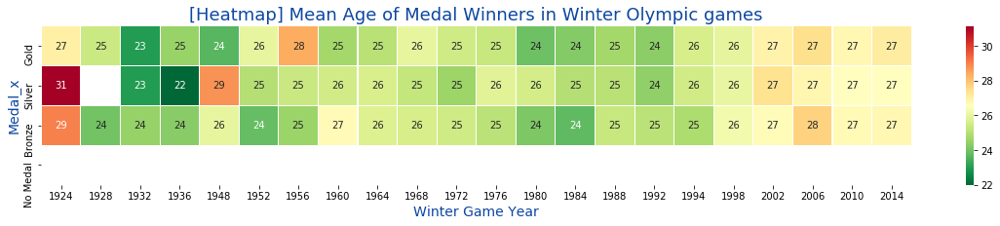

In [302]:
year_sport_age = athlete_events[athlete_events['Season']=='Winter'].pivot_table(athlete_events, index=['Year','Medal_x'], aggfunc=np.mean).reset_index()[['Year','Medal_x','Age']]
year_sport_age = year_sport_age.pivot("Medal_x", "Year", "Age")
year_sport_age = year_sport_age.reindex(["Gold","Silver","Bronze","No Medal"])
f, ax = plt.subplots(figsize=(20, 3))
sns.heatmap(year_sport_age, annot=True, linewidths=0.05, ax=ax, cmap="RdYlGn_r")
ax.set_xlabel('Winter Game Year', size=14, color="#0D47A1")
ax.set_ylabel('Medal_x', size=14, color="#0D47A1")
ax.set_title('[Heatmap] Mean Age of Medal Winners in Winter Olympic games', size=18, color="#0D47A1")
plt.show()